* The functions are kindly provided from Nadav Yayon (ny1@sanger.ac.uk)
* from `TissueTag: OrganAxis` packages

# Read modules

In [1]:
import os
import numpy as np 
# from bokeh.plotting import show, output_notebook
import pandas as pd
import socket
# os.chdir(path_to_tissue_tag)
# import tissue_tag as tt
import matplotlib.pyplot as plt
import scanpy as sc
# output_notebook()
# host = '5016'

# Function

In [2]:
# kk18
# based on a cell2location function
def select_multislide(adata, s, s_col='sample'):

    slides = adata[adata.obs[s_col].isin(s), :]
    s_keys = list(slides.uns['spatial'].keys())
    
    uns_dict = {}
    for ss in s:
        s_spatial=np.array(s_keys)[[ss in k for k in s_keys]][0]
        uns_dict[s_spatial]=slides.uns['spatial'][s_spatial]
    
    slides.uns['spatial'] = uns_dict

    return slides

# ny1, TissueTag:OrganAxis
def axis_2p_norm(
    Dist2ClusterAll,
    structure_list,
    weights = [1,1], 
):
    import warnings
    warnings.filterwarnings("ignore")
    # CMA calculations 
    fa = weights[0]
    fb = weights[0]
    axis = np.array([( fa*int(a) - fb*int(b) ) / ( fa*int(a) + fb*int(b) ) for a,b in zip(Dist2ClusterAll[structure_list[0]], Dist2ClusterAll[structure_list[1]])])
    return axis

# ny1, TissueTag:OrganAxis
def dist2cluster(df, annotation, ppm, KNN=4, calc_dist=True, logscale=False):
    """
    Calculates the minimal Euclidean distance of each point in space to an anatomical structure.

    Parameters
    ----------
    df : pandas.DataFrame
        Dataframe containing spatial data.
    annotation : str
        The column in df that contains the structure annotation.
    ppm : float
        the coordinates of df in pixel scale
    KNN : int, optional
        Determines the number of closest points used to calculate the mean distance. Default is 4.
    calc_dist : bool, optional
        If true, calculates the distance. Default is True.
    logscale : bool, optional
        If true, applies a log10 transformation to the distance. Default is False.
    

    Returns
    -------
    dict
        Dictionary with the median distance for each category in the annotation column.
    """
    pd.options.mode.chained_assignment = None  # default='warn'
    from scipy.spatial import distance_matrix, distance
    print('calculating distance matrix')
    a = np.vstack([df['x'],df['y']]).astype(int)
    distM = distance.cdist(a.T,a.T, metric='euclidean')

    Dist2ClusterAll = {}
    categories = np.unique(df[annotation])

    for idx, c in enumerate(categories):
        indextmp = df[annotation] == c
        if len(np.where(indextmp)[0]) > KNN:
            print(c)
            Dist2ClusterAll[c] = np.median(np.sort(distM[indextmp, :], axis=0)[range(KNN), :], axis=0)

    for c in categories: 
        if c != 'unassigned':
            if calc_dist:
                if logscale:
                    df["L2_dist_log10_"+annotation+'_'+c] = np.log10(Dist2ClusterAll[c]/ppm)
                else:
                    df["L2_dist_"+annotation+'_'+c] = Dist2ClusterAll[c]/ppm
            df[annotation] = categories[np.argmin(np.array(list(Dist2ClusterAll.values())), axis=0)]
    
    return Dist2ClusterAll

# List of samples 

In [3]:
# selected visium slides which have transmural LV
# and annotated "tm_axis" (inmost or outmost) and "tm_axis_region-select" (LV)
path_to_annotation = '/nfs/team205/heart/visium_annotations/foetal/transmural'
samples = [x.split('_tm_axis.csv')[0] for x in os.listdir(path_to_annotation) if '_tm_axis.csv' in x]
samples.sort()
samples

['BHF_F_Hea13295830',
 'BHF_F_Hea13295831',
 'HCAHeartST10317184',
 'HCAHeartST10317185',
 'HCAHeartST10317186',
 'HCAHeartST11605165',
 'HCAHeartST11605167',
 'HCAHeartST11605168',
 'HCAHeartST13162330',
 'HCAHeartST13162331',
 'HCAHeartST13162336']

In [6]:
# sample metadata
meta=pd.read_csv('/nfs/team205/heart/anndata_objects/Foetal/metadata/HeartTeamSamples_Mappeddata_20230208.csv')
meta=meta[['Publication','sangerID', 'combinedID',
       'donor', 'donor_type', 'region', 'region_finest', 'age', 'gender',
       'facility', 'cell_or_nuclei', 'modality', 'kit_10x', 'flushed', 'status']]
meta=meta[meta['modality'].isin(['Visium','Visium-FFPE'])]

# select slides for foetal publication
meta=meta[meta['Publication'].isin(['Foetal'])]

# samples for tm_axis
meta.set_index('sangerID',inplace=True)
meta = meta.loc[samples]
meta.reset_index(inplace=True)

# group
meta['group'] = meta['modality']+'_'+meta['status']+'_'+meta['region']
meta

,sangerID,Publication,combinedID,donor,donor_type,region,region_finest,age,gender,facility,cell_or_nuclei,modality,kit_10x,flushed,status,group
0,BHF_F_Hea13295830,Foetal,na,Hst45,na,Heart,Heart,PCW-16w,na,Sanger,na,Visium-FFPE,Visium V5 Slide - FFPE v2 (CytAssist),na,Healthy,Visium-FFPE_Healthy_Heart
1,BHF_F_Hea13295831,Foetal,na,Hst45,na,Heart,Heart,PCW-16w,na,Sanger,na,Visium-FFPE,Visium V5 Slide - FFPE v2 (CytAssist),na,Healthy,Visium-FFPE_Healthy_Heart
2,HCAHeartST10317184,Foetal,na,C83,na,Heart,Heart,GA-9w4d,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Heart
3,HCAHeartST10317185,Foetal,na,C83,na,Heart,Heart,GA-9w4d,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Heart
4,HCAHeartST10317186,Foetal,na,C83,na,Heart,Heart,GA-9w4d,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Heart
5,HCAHeartST11605165,Foetal,na,Hst33,na,Heart,Heart,PCW-13w,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Heart
6,HCAHeartST11605167,Foetal,na,C92,na,Heart,Heart,GA-7w4d,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Heart
7,HCAHeartST11605168,Foetal,na,C92,na,Heart,Heart,GA-7w4d,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Heart
8,HCAHeartST13162330,Foetal,na,Hst41,na,Left ventricle,Left ventricle cross,PCW-20w,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Left ventricle
9,HCAHeartST13162331,Foetal,na,Hst41,na,Left ventricle,Left ventricle cross,PCW-20w,na,Sanger,na,Visium,Visium-v1,na,Healthy,Visium_Healthy_Left ventricle


In [7]:
# prepare dictionary
sample_dict = {}
for grp in set(meta['group']):
    sample_dict[grp] = list(meta[meta['group']==grp]['sangerID'])
sample_dict

{'Visium_Healthy_Left ventricle': ['HCAHeartST13162330', 'HCAHeartST13162331'],
 'Visium_Healthy_Heart': ['HCAHeartST10317184',
  'HCAHeartST10317185',
  'HCAHeartST10317186',
  'HCAHeartST11605165',
  'HCAHeartST11605167',
  'HCAHeartST11605168'],
 'Visium_Trisomy21_Heart': ['HCAHeartST13162336'],
 'Visium-FFPE_Healthy_Heart': ['BHF_F_Hea13295830', 'BHF_F_Hea13295831']}

# Core axis calculation per slide

In [8]:
!ls /nfs/team205/heart/anndata_objects/Foetal

14Feb_fromSemih		      RNA_foetal_post-scVI_raw.h5ad
archive			      RNA_foetal_raw.h5ad
Feb28ObjectRaw.h5ad	      scArches
Feb28ObjectRaw_Multiome.h5ad  scVI
Feb28ObjectRaw_Multiome.rds   TipAndStalkAndGVSMCsPartitionedForCell2Loc.h5ad
Feb28ObjectRaw.obs.csv	      trisomy21
Feb28ObjectRaw_original.h5ad  visium-FFPE_foetal_raw.h5ad
Feb28ObjectRaw_re-scVI.h5ad   visium_foetal_healthy-all_raw.h5ad
He_Cell_foetal-lung	      visium_foetal_healthy-all_spot-annotation.csv
Hill2022.h5ad		      visium_foetal_raw.h5ad
Hill2022_QCapplied.h5ad       visium-OCT_foetal_acrossage_raw.h5ad
Immune			      visium-OCT_foetal_DuctusA_raw.h5ad
metadata		      visium-OCT_foetal_raw.h5ad
multiome_ATAC		      visium-OCT-LV_foetal_raw.h5ad
multiVI			      visium-OCT-T21_foetal_raw.h5ad
QC


In [12]:
sc.set_figure_params(figsize=[5,5],dpi=100)

##### Visium_Healthy_Left ventricle #####
HCAHeartST13162330


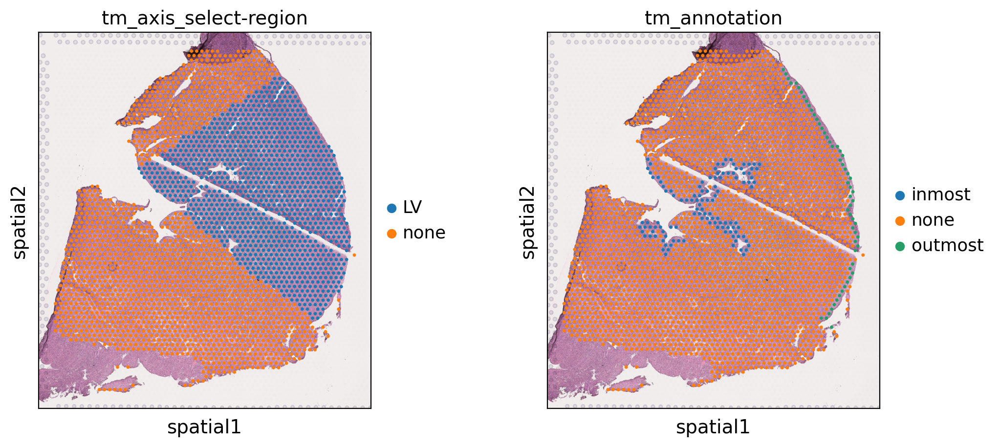

calculating distances
calculating distance matrix
inmost
none
outmost


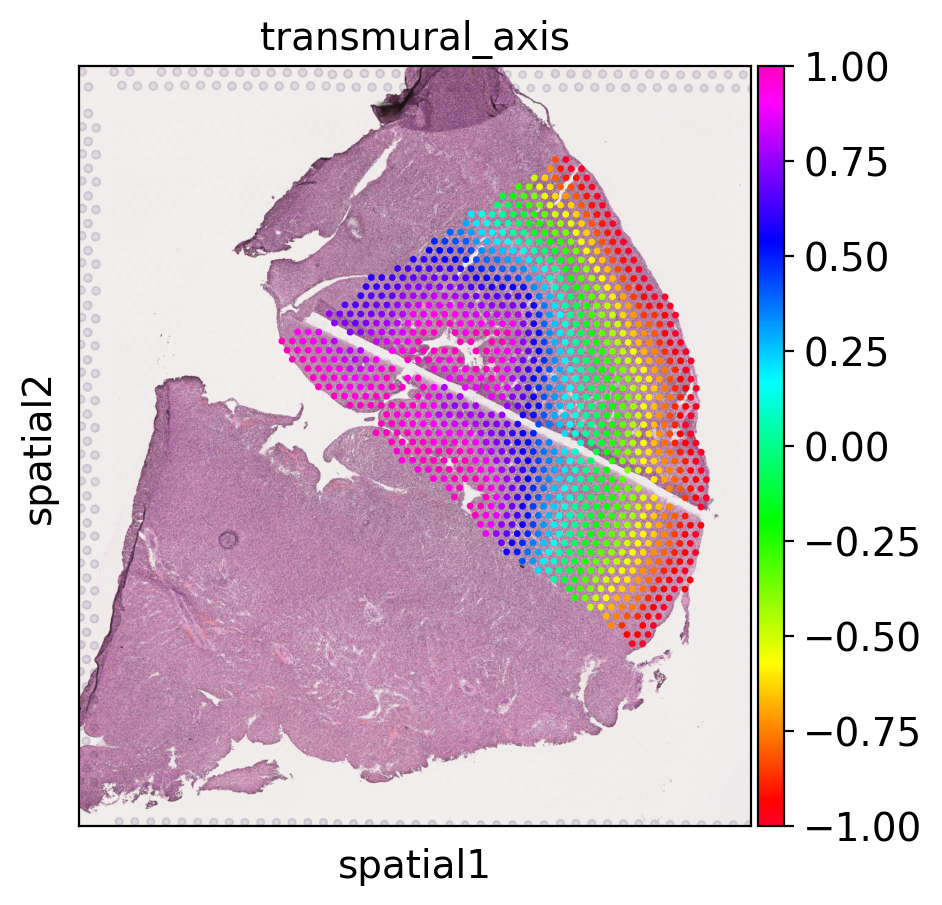

HCAHeartST13162331


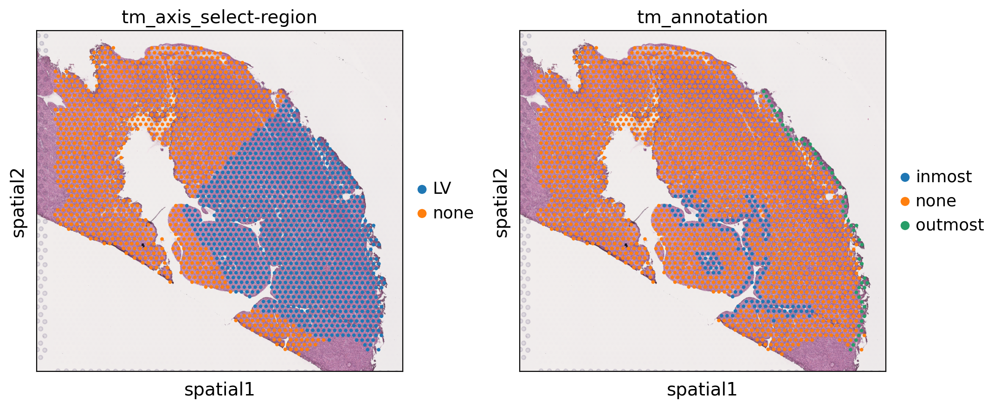

calculating distances
calculating distance matrix
inmost
none
outmost


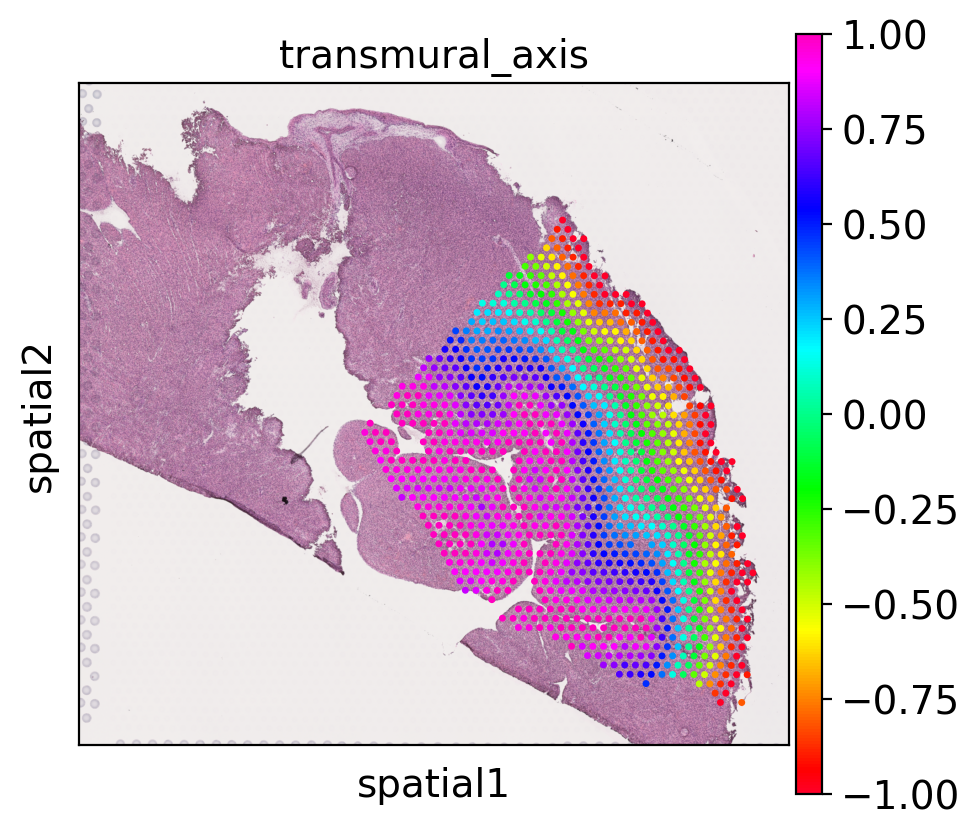

##### Visium_Healthy_Heart #####
HCAHeartST10317184


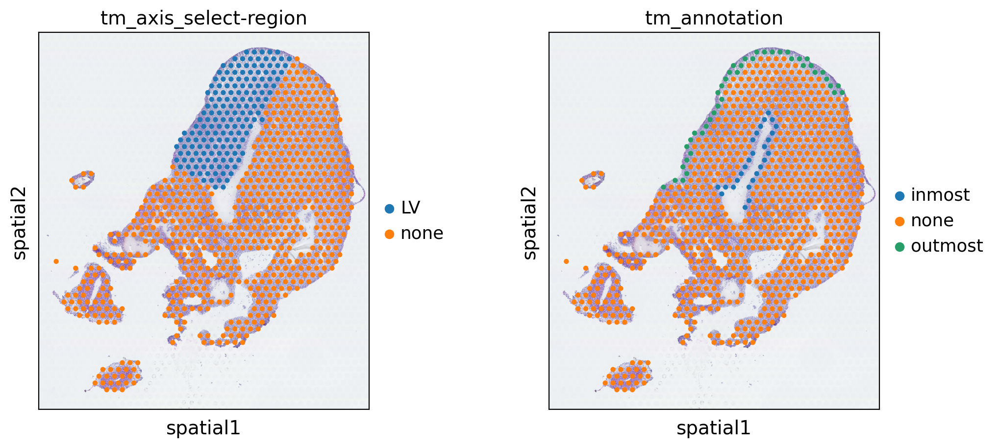

calculating distances
calculating distance matrix
inmost
none
outmost


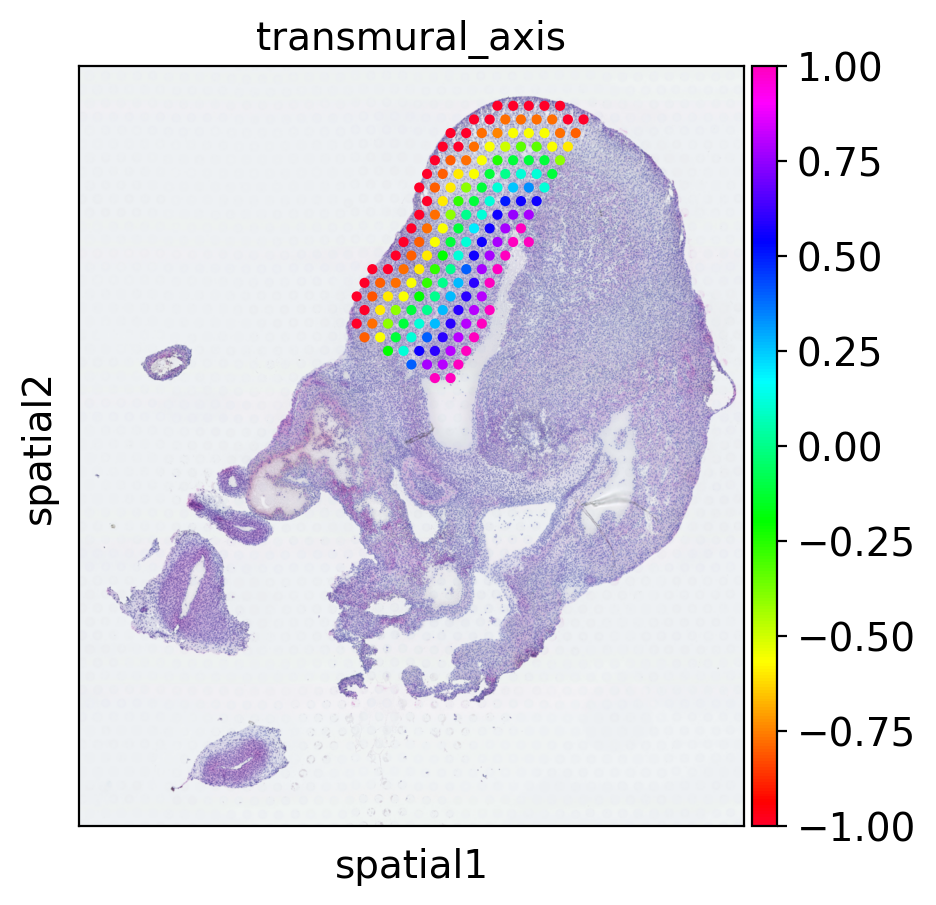

HCAHeartST10317185


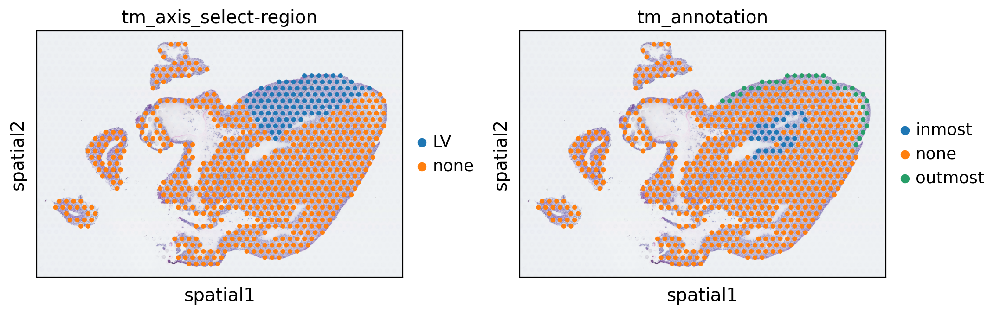

calculating distances
calculating distance matrix
inmost
none
outmost


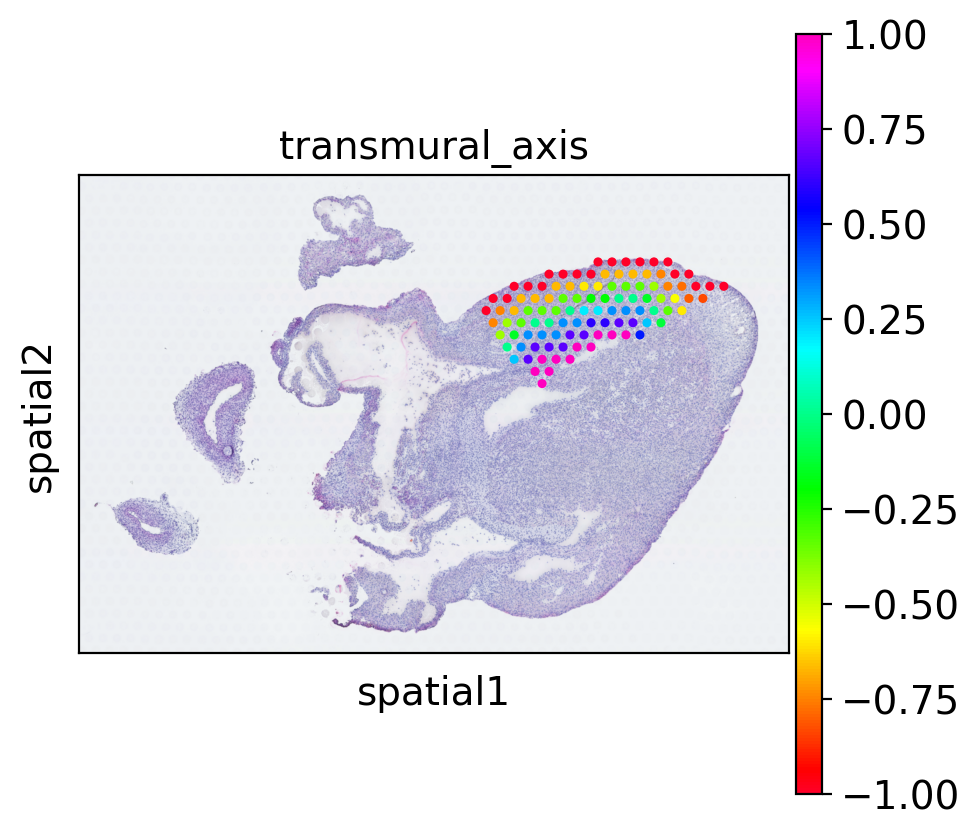

HCAHeartST10317186


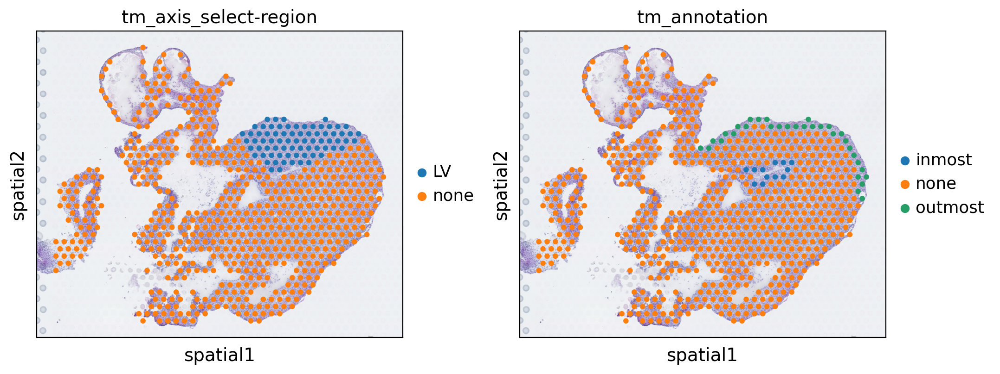

calculating distances
calculating distance matrix
inmost
none
outmost


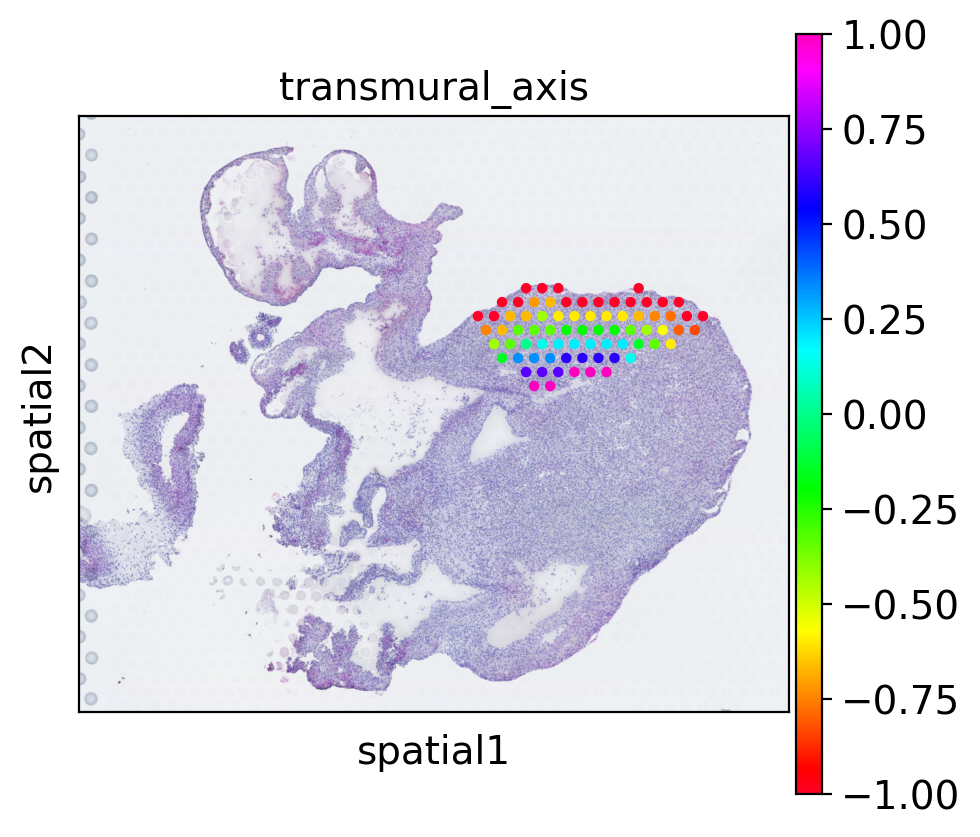

HCAHeartST11605165


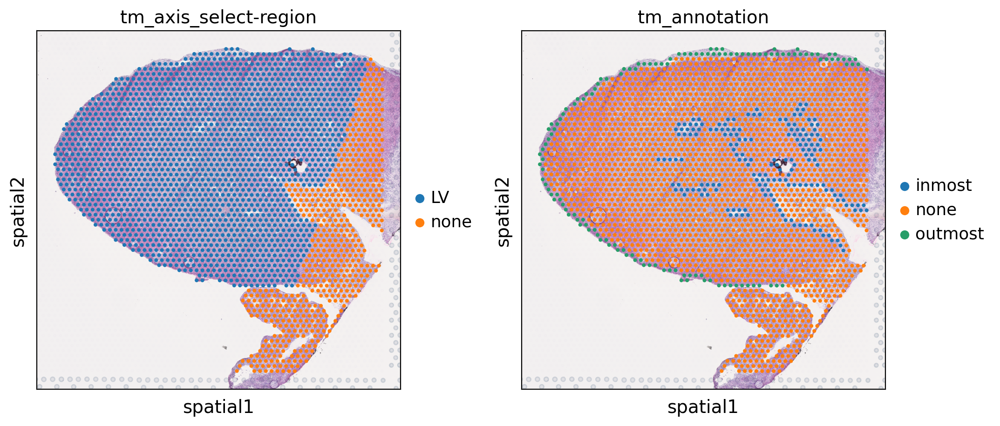

calculating distances
calculating distance matrix
inmost
none
outmost


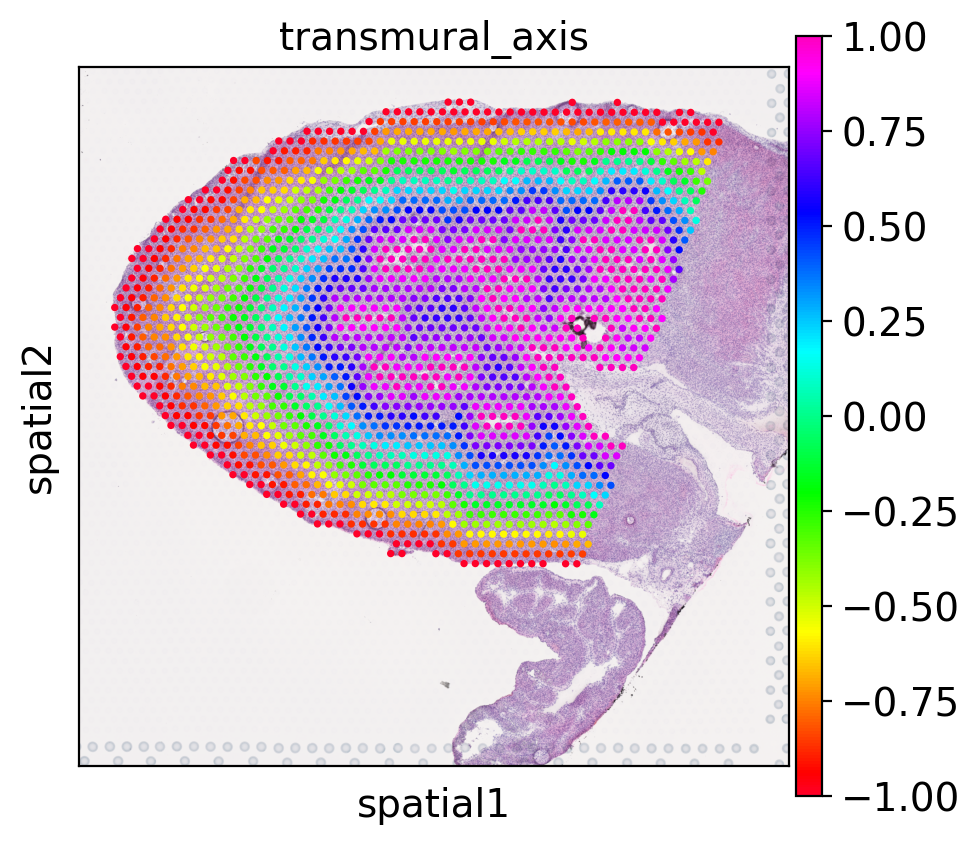

HCAHeartST11605167


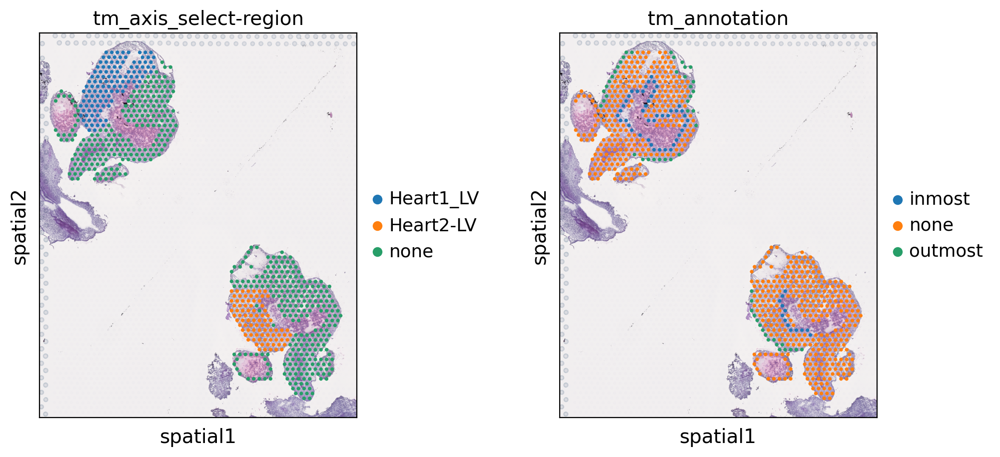

calculating distances
calculating distance matrix
inmost
none
outmost
calculating distances
calculating distance matrix
inmost
none
outmost


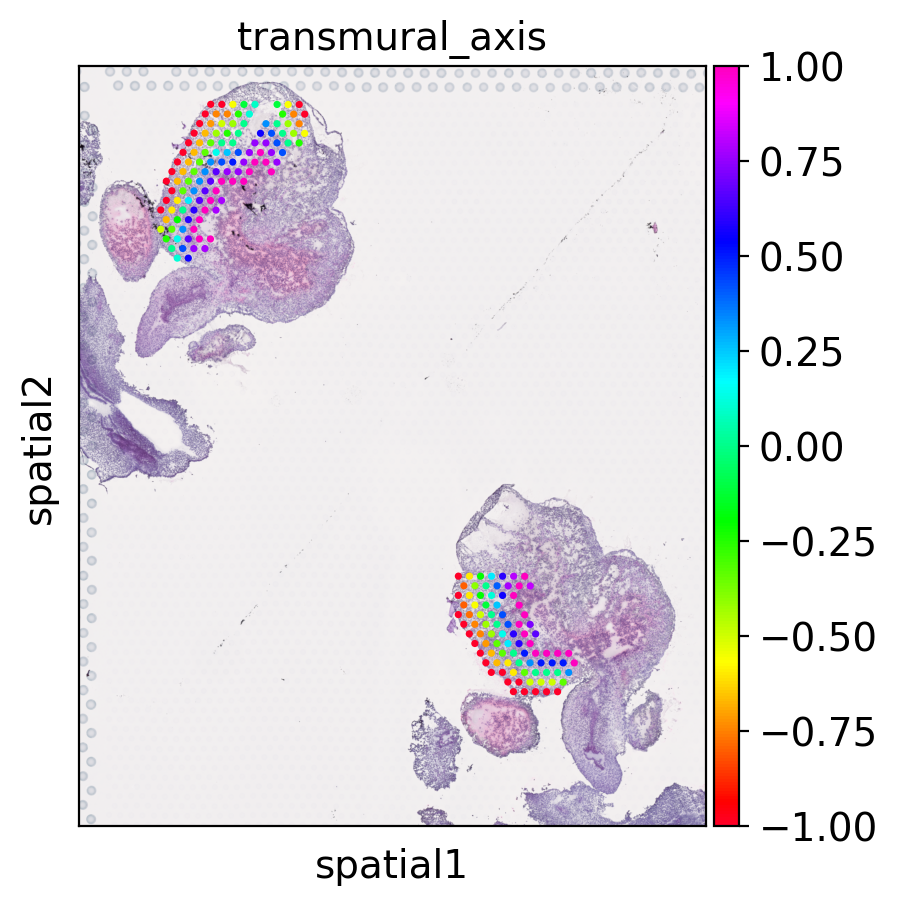

HCAHeartST11605168


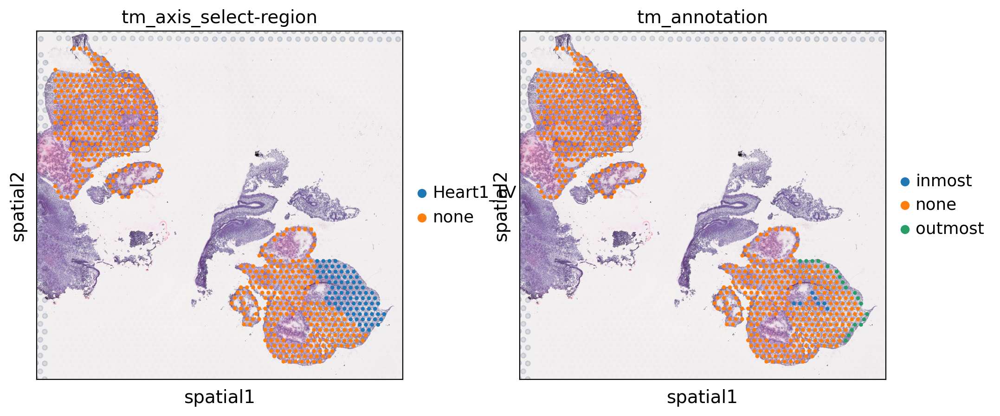

calculating distances
calculating distance matrix
inmost
none
outmost


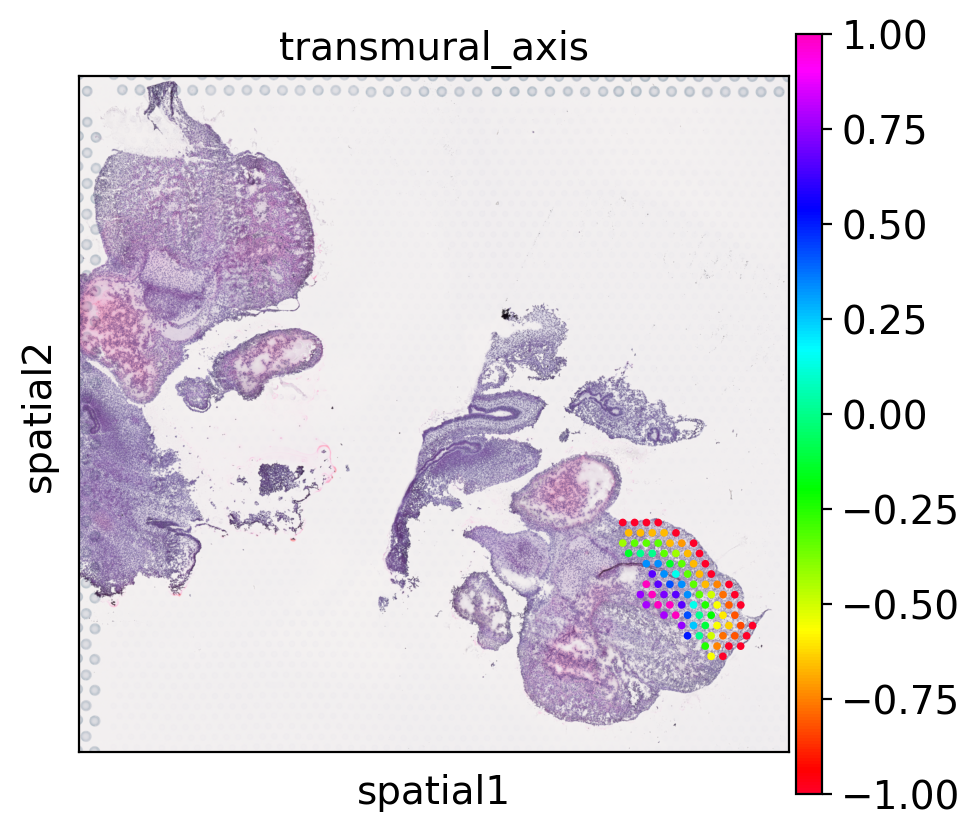

##### Visium_Trisomy21_Heart #####
HCAHeartST13162336


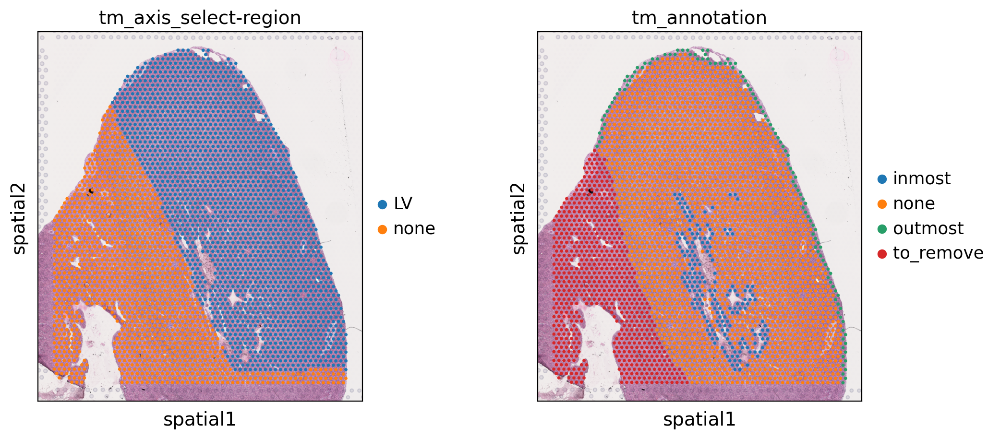

calculating distances
calculating distance matrix
inmost
none
outmost


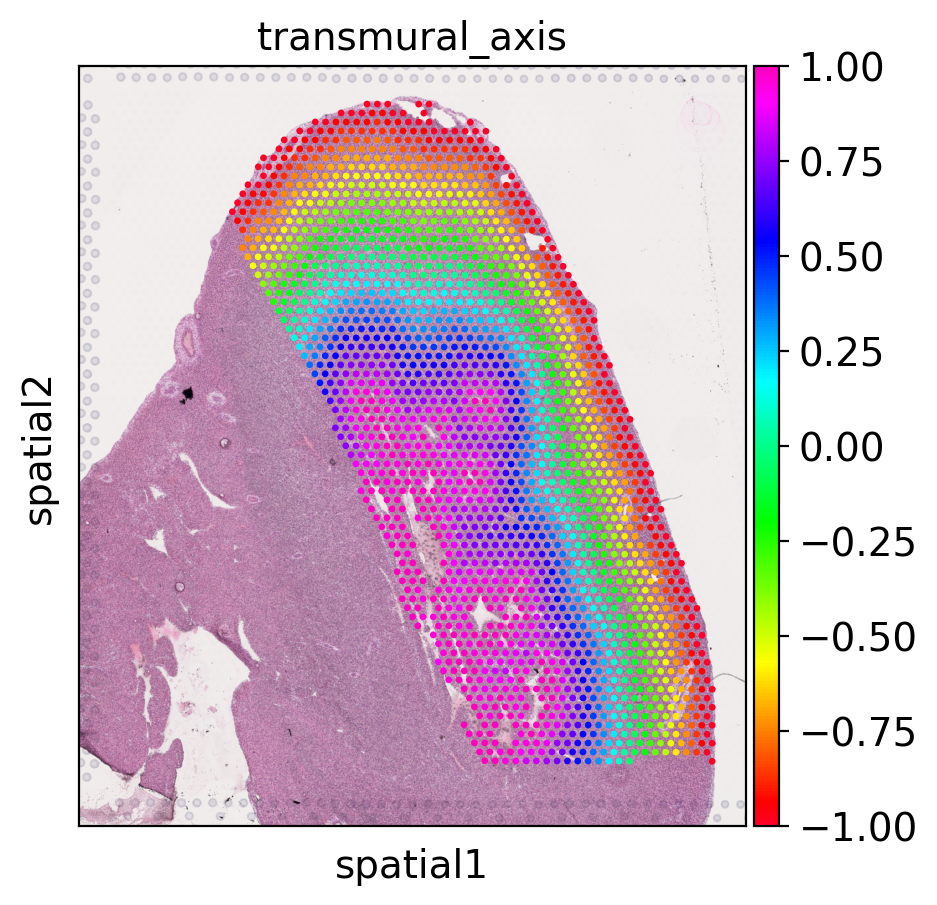

##### Visium-FFPE_Healthy_Heart #####
BHF_F_Hea13295830


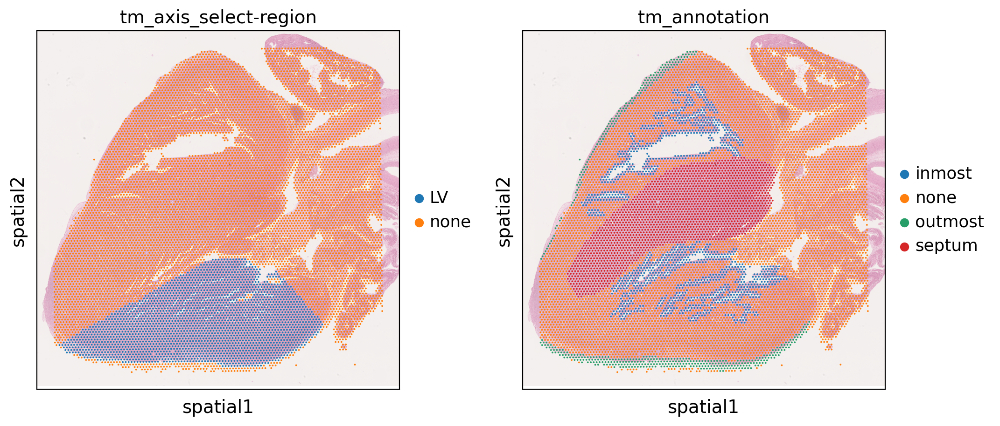

calculating distances
calculating distance matrix
inmost
none
outmost


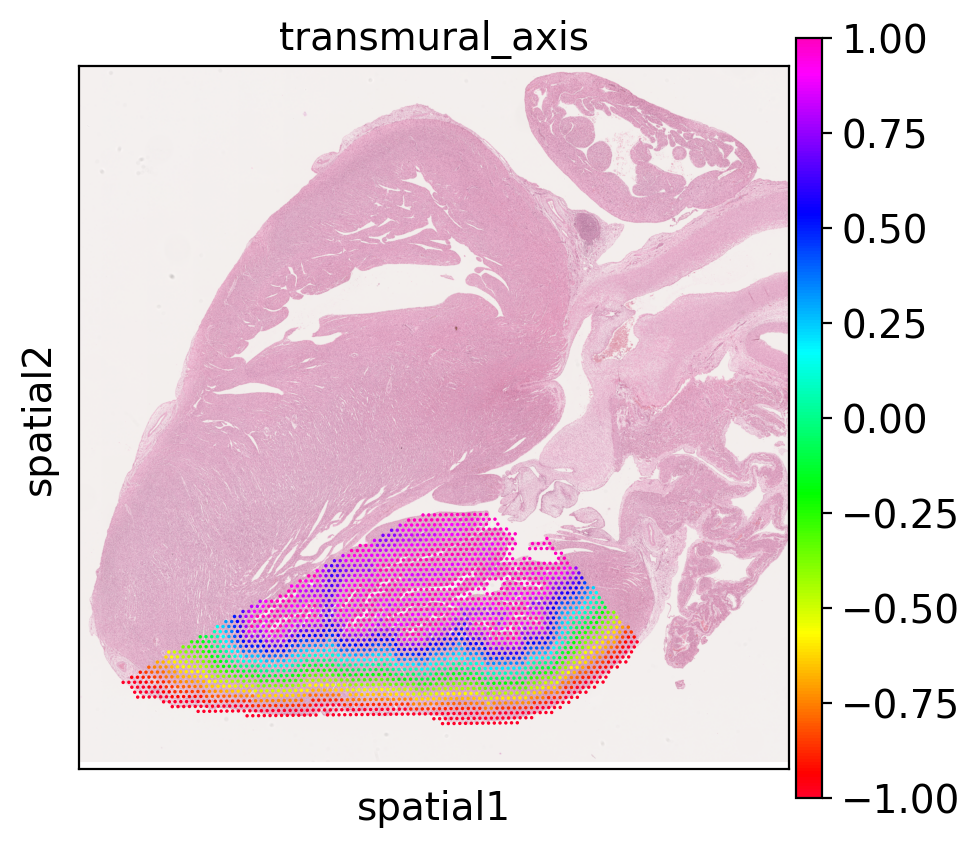

BHF_F_Hea13295831


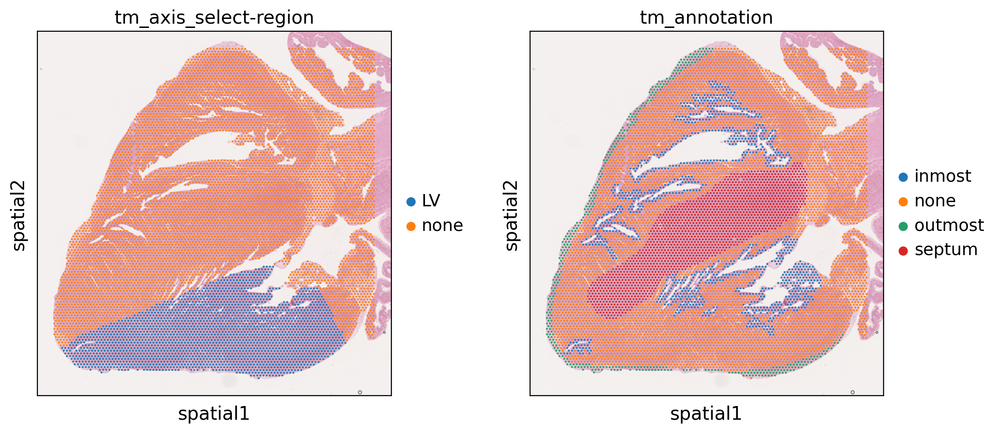

calculating distances
calculating distance matrix
inmost
none
outmost


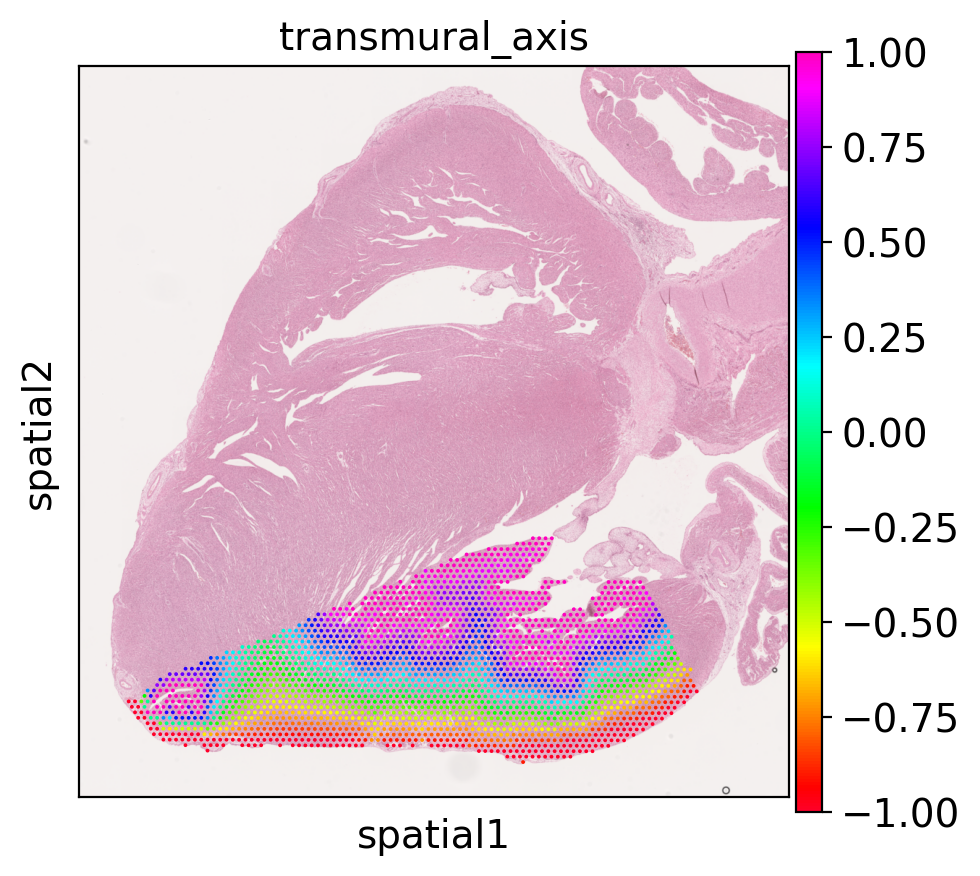

In [14]:
for grp in sample_dict.keys():
    print(f'##### {grp} #####')
    
    # read in visium adata object
    if grp=='Visium-FFPE_Healthy_Heart':
        adata_vis = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium-FFPE_foetal_raw.h5ad')
    elif grp=='Visium_Healthy_Heart':
        adata_vis = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium-OCT_foetal_raw.h5ad')
    elif grp=='Visium_Healthy_Left ventricle':
        adata_vis = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium-OCT-LV_foetal_raw.h5ad')
    elif grp=='Visium_Trisomy21_Heart':
        adata_vis = sc.read_h5ad('/nfs/team205/heart/anndata_objects/Foetal/visium-OCT-T21_foetal_raw.h5ad')    
    adata_vis.obs['array_row'] = adata_vis.obs['array_row'].astype('int')
    adata_vis.obs['array_col'] = adata_vis.obs['array_col'].astype('int')
    adata_vis.obsm['spatial'] = adata_vis.obsm['spatial'].astype('int')

    for slide_id in sample_dict[grp]:
        print(slide_id) 
        # select one slide
        slide = select_multislide(adata_vis, [slide_id], s_col='sample')

        # read in annotation file and add
        ## annotation to select
        annot_select_region = pd.read_csv(f'{path_to_annotation}/{slide_id}_tm_axis_select-region.csv',index_col=0)
        annot_select_region.index = slide_id+'_'+annot_select_region.index
        annot_select_region.fillna('none',inplace=True)
        slide.obs['tm_axis_select-region'] = annot_select_region['tm_axis_select-region'].reindex(slide.obs_names)
        ## annotation, transmural
        annot_tm = pd.read_csv(f'{path_to_annotation}/{slide_id}_tm_axis.csv',index_col=0)
        annot_tm.index = slide_id+'_'+annot_tm.index
        annot_tm.fillna('none',inplace=True)
        slide.obs['tm_annotation'] = annot_tm['tm_axis'].reindex(slide.obs_names)
        ## plot
        sc.pl.spatial(slide,color=['tm_axis_select-region','tm_annotation'],ncols=2,wspace=0.2)

        # prepare dataframe for distance calculation
        obs_df = slide.obs.copy()
        obs_df.rename(columns={'array_row':'y','array_col':'x'},inplace=True)

        regions_to_select = [x for x in set(obs_df['tm_axis_select-region']) if x!='none']
        # if the slide has one heart 
        if len(regions_to_select)==1: 
            # select region
            obs_df_sel = obs_df[obs_df['tm_axis_select-region']==regions_to_select[0]]
    
            # calculate distance
            print('calculating distances')
            dist2clusterall = dist2cluster(obs_df_sel,annotation='tm_annotation',KNN=1,ppm=1)
            slide.obs.loc[obs_df_sel.index,obs_df_sel.columns] = obs_df_sel.copy()
    
            # calculate core axis
            arr = axis_2p_norm(
                dist2clusterall,
                ['outmost','inmost'],
                weights = [1,1], 
            )
            slide.obs.loc[obs_df_sel.index,'transmural_axis'] = arr
        
        # if the slide has multiple heart
        elif len(regions_to_select)>1:
            for region in regions_to_select:
                # select region
                obs_df_sel = obs_df[obs_df['tm_axis_select-region']==region]
        
                # calculate distance
                print('calculating distances')
                dist2clusterall = dist2cluster(obs_df_sel,annotation='tm_annotation',KNN=1,ppm=1)
                slide.obs.loc[obs_df_sel.index,obs_df_sel.columns] = obs_df_sel.copy()
        
                # calculate core axis
                arr = axis_2p_norm(
                    dist2clusterall,
                    ['outmost','inmost'],
                    weights = [1,1], 
                )
                slide.obs.loc[obs_df_sel.index,'transmural_axis'] = arr

        # plot
        sc.pl.spatial(slide,color=['transmural_axis'],cmap='gist_rainbow',ncols=2,wspace=0.25)
        # save axis
        slide.obs[['transmural_axis']].to_csv(f'/nfs/team205/heart/visium_axis/foetal/transmural_LV/{slide_id}.csv')         

In [15]:
!ls /nfs/team205/heart/visium_axis/foetal/transmural_LV

BHF_F_Hea13295830.csv	HCAHeartST10317186.csv	HCAHeartST13162330.csv
BHF_F_Hea13295831.csv	HCAHeartST11605165.csv	HCAHeartST13162331.csv
HCAHeartST10317184.csv	HCAHeartST11605167.csv	HCAHeartST13162336.csv
HCAHeartST10317185.csv	HCAHeartST11605168.csv
